In [1]:
import scipy.io
import jax.numpy as np
import nibabel as nib
from scipy.io import loadmat 
import numpy as onp
import matplotlib.pyplot as plt 
import os
import shutil
from PIL import Image
from inrmri.bart import bart_acquisition_from_arrays
from inrmri.data_harvard import get_csmaps_and_mask, get_reference_reco
import pandas as pd
from jax import jit, vmap, random
from inrmri.dip import TimeDependant_DIP_Net, helix_generator, circle_generator
from inrmri.new_radon import ForwardRadonOperator
from inrmri.fourier import fastshiftfourier, get_freqs
from inrmri.basic_nn import weighted_loss 
from inrmri.utils import to_complex, is_inside_of_radial_lim, meshgrid_from_subdiv_autolims, total_variation_batch_complex, save_matrix_and_dict_in_zpy, load_matrix_and_dict_from_zpy    
from inrmri.utils import create_exp_file_name, total_variation_complex
import optax 
from inrmri.metrics_rd import mean_psnr, mean_ssim, mean_artifact_power
from inrmri.utils_rdls import seconds_to_min_sec_format, filter_and_get_columns, apply_transform

In [2]:
from inrmri.image_processor import BeforeLinRegNormalizer
from inrmri.basic_plotting import full_halph_FOV_space_time 
from inrmri.image_processor import reduce_FOV 

In [3]:
from inrmri.utils_rdls import safe_normalize, get_center

In [4]:
dict_plot = {
    'DATA_1.5T': {
        'GC': {
            1: {'crop_ns': [35,50,55,30], 'saturation': 0.25},
            2: {'crop_ns': [35,50,55,30], 'saturation': 0.25}, # done
            3: {'crop_ns': [32,57,55,27], 'saturation': 0.3}, # done
            4: {'crop_ns': [32,47,57,27], 'saturation': 0.4}, # done
            5: {'crop_ns': [25,55,50,30], 'saturation': 0.5}, # done
            6: {'crop_ns': [23,55,48,30], 'saturation': 0.5}, # done
            7: {'crop_ns': [25,55,50,30], 'saturation': 0.5},
            8: {'crop_ns': [25,55,50,30], 'saturation': 0.5},
        },
        'CM': {
            1: {'crop_ns': [32,43,30,40], 'saturation': 0.4},
            2: {'crop_ns': [32,43,30,40], 'saturation': 0.4},
            3: {'crop_ns': [32,43,30,40], 'saturation': 0.4}, # done
            4: {'crop_ns': [35,40,35,40], 'saturation': 0.4}, # done
            5: {'crop_ns': [35,40,35,40], 'saturation': 0.4}, # done
            6: {'crop_ns': [35,40,40,34], 'saturation': 0.4}, # done
            7: {'crop_ns': [35,40,35,40], 'saturation': 0.4}, # done
            8: {'crop_ns': [35,40,35,40], 'saturation': 0.4},
        },
        'DW': {
            1: {'crop_ns': [28,45,50,25], 'saturation': 0.6},
            2: {'crop_ns': [28,45,50,25], 'saturation': 0.6}, # done
            3: {'crop_ns': [28,45,50,25], 'saturation': 0.6}, # done
            4: {'crop_ns': [28,45,50,25], 'saturation': 0.6}, # done
            5: {'crop_ns': [30,45,50,25], 'saturation': 0.6}, # done
            6: {'crop_ns': [30,45,50,25], 'saturation': 0.6},
            7: {'crop_ns': [30,45,50,25], 'saturation': 0.6}, 
            8: {'crop_ns': [30,45,50,25], 'saturation': 0.6},
        },
    },
    'DATA_0.55T': {
        'MP': {
            1: {'crop_ns': [40,35,35,40], 'saturation': 0.3}, # done
            2: {'crop_ns': [40,35,35,40], 'saturation': 0.3}, # done
            3: {'crop_ns': [40,35,35,40], 'saturation': 0.3}, # done
            4: {'crop_ns': [40,35,35,40], 'saturation': 0.3}, # done
            5: {'crop_ns': [40,40,40,40], 'saturation': 0.3}, # done
            6: {'crop_ns': [40,40,40,40], 'saturation': 0.3},
            7: {'crop_ns': [40,40,40,40], 'saturation': 0.3},
            8: {'crop_ns': [40,40,40,40], 'saturation': 0.3},
        },
        'FH': {
            1: {'crop_ns': [32,40,35,35], 'saturation': 0.3}, 
            2: {'crop_ns': [32,40,35,35], 'saturation': 0.3}, # done
            3: {'crop_ns': [32,40,33,38], 'saturation': 0.3}, # done
            4: {'crop_ns': [32,40,33,38], 'saturation': 0.3}, # done
            5: {'crop_ns': [32,40,33,38], 'saturation': 0.3}, # done
            6: {'crop_ns': [32,40,33,38], 'saturation': 0.3}, # done
            7: {'crop_ns': [32,40,33,38], 'saturation': 0.3},
            8: {'crop_ns': [32,40,33,38], 'saturation': 0.3},
        }, 
        'TC': {
            1: {'crop_ns': [32,42,48,37], 'saturation': 0.2},
            2: {'crop_ns': [40,40,45,40], 'saturation': 0.2}, # done
            3: {'crop_ns': [40,40,45,40], 'saturation': 0.2}, # done
            4: {'crop_ns': [40,40,45,40], 'saturation': 0.2}, # done
            5: {'crop_ns': [40,45,45,40], 'saturation': 0.2}, # done
            6: {'crop_ns': [40,45,45,40], 'saturation': 0.25}, # done
            7: {'crop_ns': [40,45,45,40], 'saturation': 0.25},
            8: {'crop_ns': [40,45,45,40], 'saturation': 0.25},
        }, 
        'RF': {
            1: {'crop_ns': [38,42,45,40], 'saturation': 0.2},
            2: {'crop_ns': [38,42,45,40], 'saturation': 0.2}, # done
            3: {'crop_ns': [38,42,45,40], 'saturation': 0.2}, # done
            4: {'crop_ns': [38,42,45,40], 'saturation': 0.25}, # done
            5: {'crop_ns': [38,42,45,40], 'saturation': 0.25}, # done
            6: {'crop_ns': [38,42,45,40], 'saturation': 0.25}, # done
            7: {'crop_ns': [38,42,45,40], 'saturation': 0.25},
            8: {'crop_ns': [38,42,45,40], 'saturation': 0.25},
        }, 
        'JB': {
            1: {'crop_ns': [40,38,48,30], 'saturation': 0.4},
            2: {'crop_ns': [40,38,48,30], 'saturation': 0.4}, # done
            3: {'crop_ns': [40,38,48,30], 'saturation': 0.5}, # done
            4: {'crop_ns': [40,38,48,30], 'saturation': 0.5}, # done
            5: {'crop_ns': [40,38,48,30], 'saturation': 0.5}, # done
            6: {'crop_ns': [40,38,48,30], 'saturation': 0.5}, # done
            7: {'crop_ns': [40,38,48,30], 'saturation': 0.5},
            8: {'crop_ns': [40,38,48,30], 'saturation': 0.5},
        }, 
        'FE': {
            1: {'crop_ns': [40,40,42,38], 'saturation': 0.25},
            2: {'crop_ns': [40,40,42,38], 'saturation': 0.25}, # done
            3: {'crop_ns': [40,40,42,38], 'saturation': 0.25}, # done
            4: {'crop_ns': [38,42,38,36], 'saturation': 0.25}, # done
            5: {'crop_ns': [36,42,38,36], 'saturation': 0.35}, # done 
            6: {'crop_ns': [36,42,38,36], 'saturation': 0.35}, # done 
            7: {'crop_ns': [36,42,38,36], 'saturation': 0.4}, # done
            8: {'crop_ns': [36,42,38,36], 'saturation': 0.5}, # done
        }, 
        'DB': {
            1: {'crop_ns': [34,40,45,30], 'saturation': 0.25},
            2: {'crop_ns': [34,40,45,30], 'saturation': 0.25}, # done
            3: {'crop_ns': [34,40,45,30], 'saturation': 0.25}, # done
            4: {'crop_ns': [34,40,45,30], 'saturation': 0.25}, # done
            5: {'crop_ns': [34,40,45,30], 'saturation': 0.25}, # done
            6: {'crop_ns': [34,42,45,30], 'saturation': 0.25}, # done
            7: {'crop_ns': [34,42,45,30], 'saturation': 0.25},
            8: {'crop_ns': [34,42,45,30], 'saturation': 0.25},
        }, 
        'FP': {
            1: {'crop_ns': [35,42,45,30], 'saturation': 0.35},
            2: {'crop_ns': [35,42,45,30], 'saturation': 0.35}, # done
            3: {'crop_ns': [35,42,45,30], 'saturation': 0.35}, # done
            4: {'crop_ns': [35,42,45,30], 'saturation': 0.35}, # done
            5: {'crop_ns': [35,42,45,30], 'saturation': 0.35},
            6: {'crop_ns': [35,42,45,30], 'saturation': 0.35},
            7: {'crop_ns': [35,42,45,30], 'saturation': 0.35}, # done
            8: {'crop_ns': [35,42,45,30], 'saturation': 0.35},
        }, 
        'AA': {
            1: {'crop_ns': [35,42,45,30], 'saturation': 0.3},
            2: {'crop_ns': [35,42,45,30], 'saturation': 0.3}, # done
            3: {'crop_ns': [35,42,45,30], 'saturation': 0.3}, # done
            4: {'crop_ns': [35,42,45,30], 'saturation': 0.3}, # done
            5: {'crop_ns': [35,42,45,30], 'saturation': 0.3}, # done
            6: {'crop_ns': [35,42,45,30], 'saturation': 0.3}, # done
            7: {'crop_ns': [35,42,45,30], 'saturation': 0.3},
            8: {'crop_ns': [35,42,45,30], 'saturation': 0.3},
        }, 
        'DP': {
            1: {'crop_ns': [25,60,40,35], 'saturation': 0.2},
            2: {'crop_ns': [25,60,40,35], 'saturation': 0.2}, # done
            3: {'crop_ns': [25,55,40,35], 'saturation': 0.2}, # done
            4: {'crop_ns': [25,55,40,35], 'saturation': 0.2}, # done
            5: {'crop_ns': [25,55,40,35], 'saturation': 0.2}, # done
            6: {'crop_ns': [25,55,40,35], 'saturation': 0.2}, # done
            7: {'crop_ns': [25,55,40,40], 'saturation': 0.2}, # done
            8: {'crop_ns': [25,55,40,40], 'saturation': 0.2},
        }, 
    }
}

dict_trans = {
    'DATA_1.5T': {
        'GC': {
            'flip_h': False,
            'flip_v': False,
            'rot': 0,
        },
        'CM': {
            'flip_h': False,
            'flip_v': False,
            'rot': 0,
        },
        'DW': {
            'flip_h': False,
            'flip_v': False,
            'rot': 0,
        },
    },
    'DATA_0.55T': {
        'MP': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        },
        'FH': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        }, 
        'TC': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        }, 
        'RF': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        }, 
        'JB': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        }, 
        'FE': {
            'flip_h': True,
            'flip_v': False,
            'rot': 0,
        }, 
        'DB': {
            'flip_h': True,
            'flip_v': False,
            'rot': 0,
        },
        'FP': {
            'flip_h': False,
            'flip_v': False,
            'rot': 0,
        },
        'AA': {
            'flip_h': True,
            'flip_v': False,
            'rot': 0,
        },
        'DP': {
            'flip_h': False,
            'flip_v': False,
            'rot': 0,
        },
    }
}


gt_trans = {
    'DATA_0.55T': {
        'FP': {
            'flip_h': False,
            'flip_v': False,
            'rot': 90,
        },
        'DP': {
            'flip_h': True,
            'flip_v': True,
            'rot': 0,
        },
    }
}

## General

In [5]:
total_slices = 8
num_frames   = 30
slice_num             = 7
base_path    = '/mnt/workspace/datasets/pulseqCINE/'
dataset      = 'DATA_0.55T'
add_psnr = False
add_ssim = False
add_time = True
target_columns = ['training_name', 'psnr', 'ssim', 'it', 'duration [min]', 'duration [s]']

In [6]:
stdip_parameters = {
    'experiment_name': 'total_kiter_nspokes', 
    'training_params': {
        'total_kiter':2000,
        'nspokes':15,
        'slice':None,
    }
}
tddip_parameters = {
    'experiment_name': 'total_kiter', 
    'training_params': {
        'total_kiter':2000,
        'slice':None,
    }
}
stdip_summray_parameters = stdip_parameters['training_params']
stdip_summray_parameters.pop('slice', None)
tddip_summray_parameters = tddip_parameters['training_params']
tddip_summray_parameters.pop('slice', None)

volunteer:  MP


2025-06-23 13:26:50.840065: W external/xla/xla/service/gpu/nvptx_compiler.cc:836] The NVIDIA driver's CUDA version is 12.2 which is older than the PTX compiler version (12.6.20). Because the driver is older than the PTX compiler version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  FH
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  TC
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5


/mnt/workspace/rdelasotta/NF-cMRI/inrmri/basic_plotting.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(4,nrecos, figsize=(nrecos * scale*xy_proportion[0],scale*xy_proportion[1]), layout='constrained', height_ratios=ht_ratios, dpi=dpi) #


slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  RF
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  JB
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  FE
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  DB
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  FP
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  AA
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8
volunteer:  DP
slice_num:  1
slice_num:  2
slice_num:  3
slice_num:  4
slice_num:  5
slice_num:  6
slice_num:  7
slice_num:  8


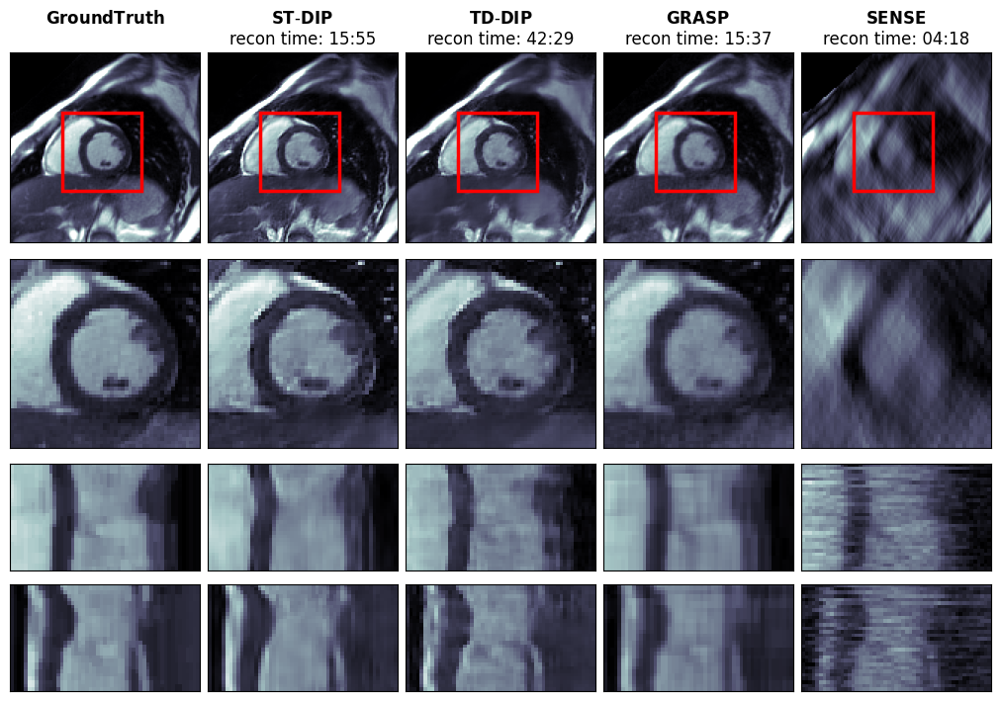

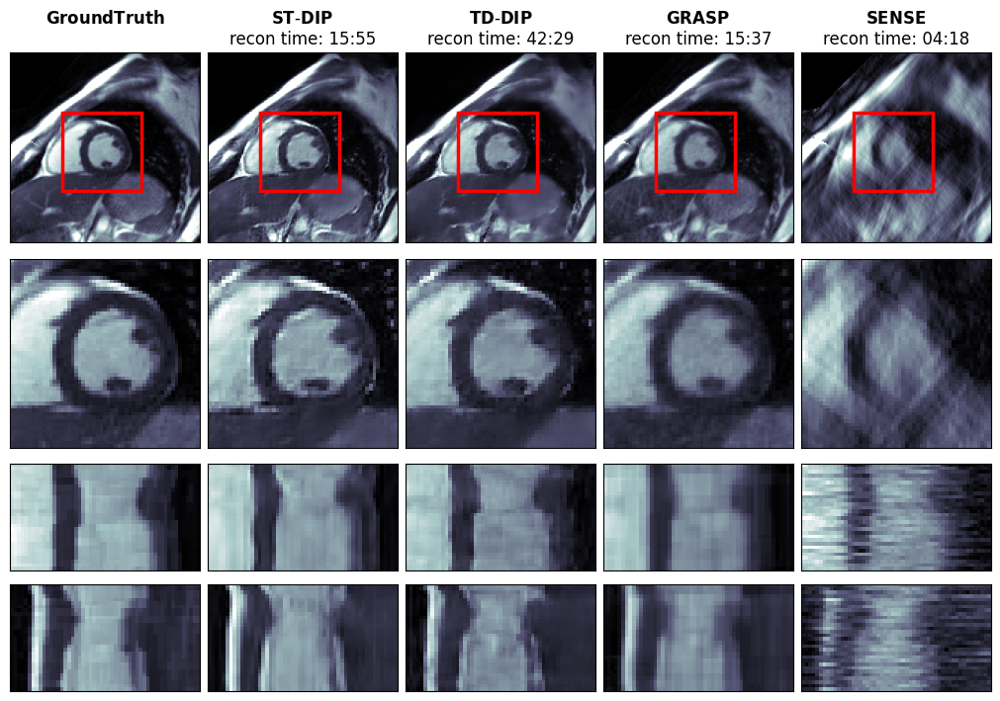

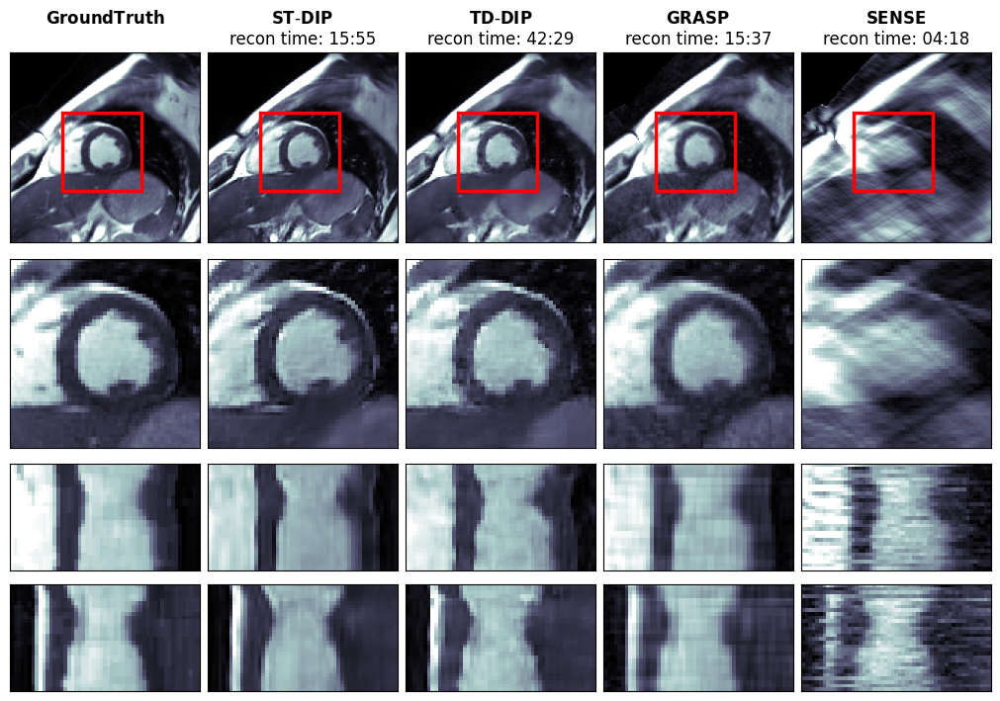

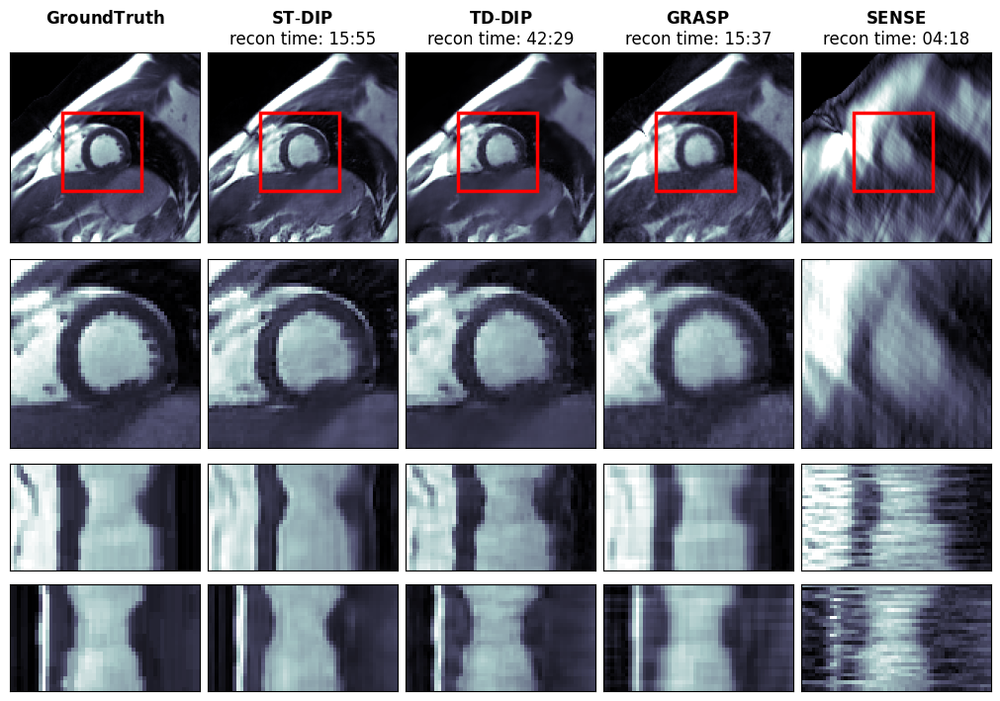

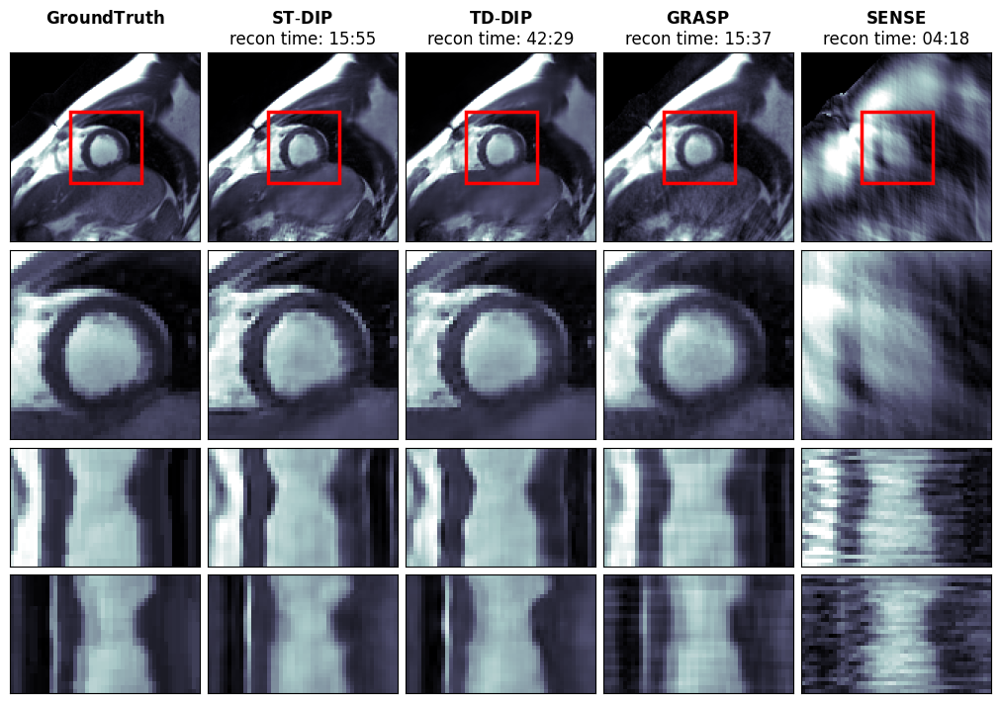

...

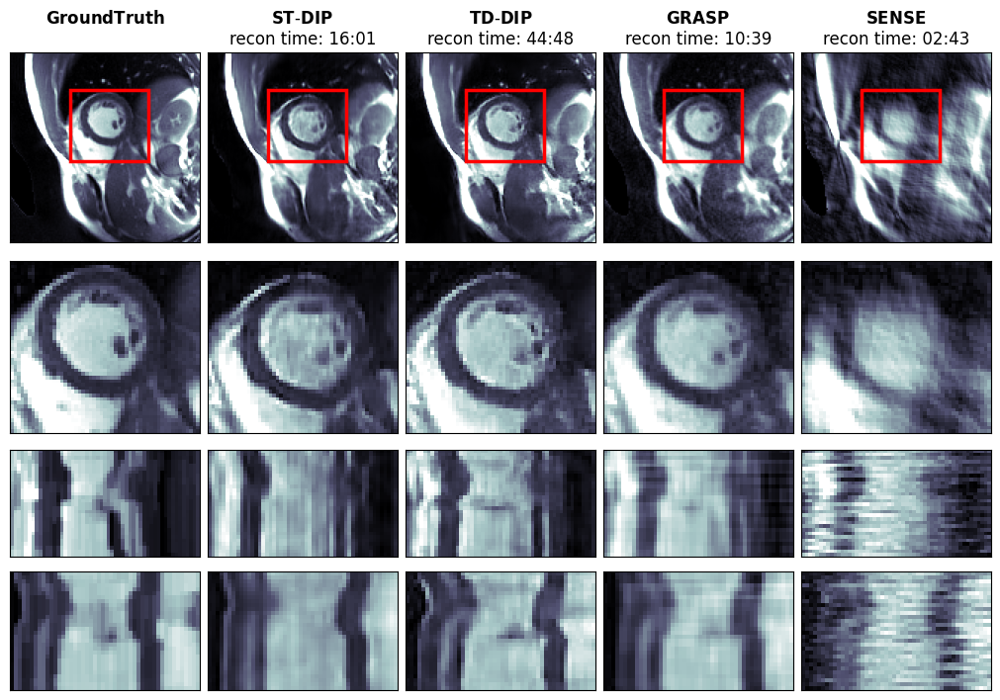

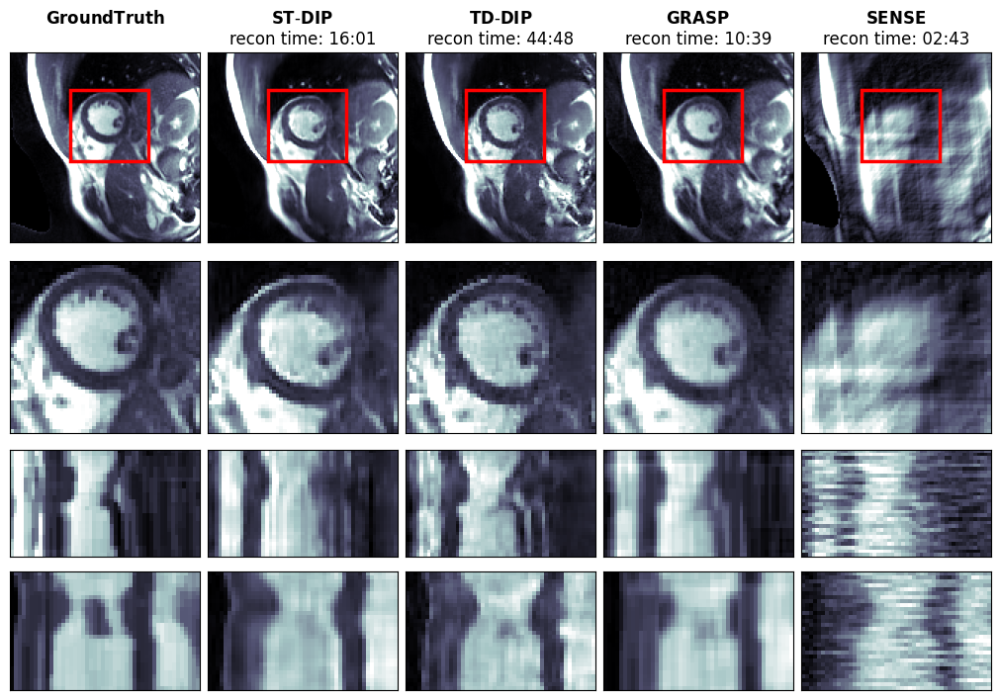

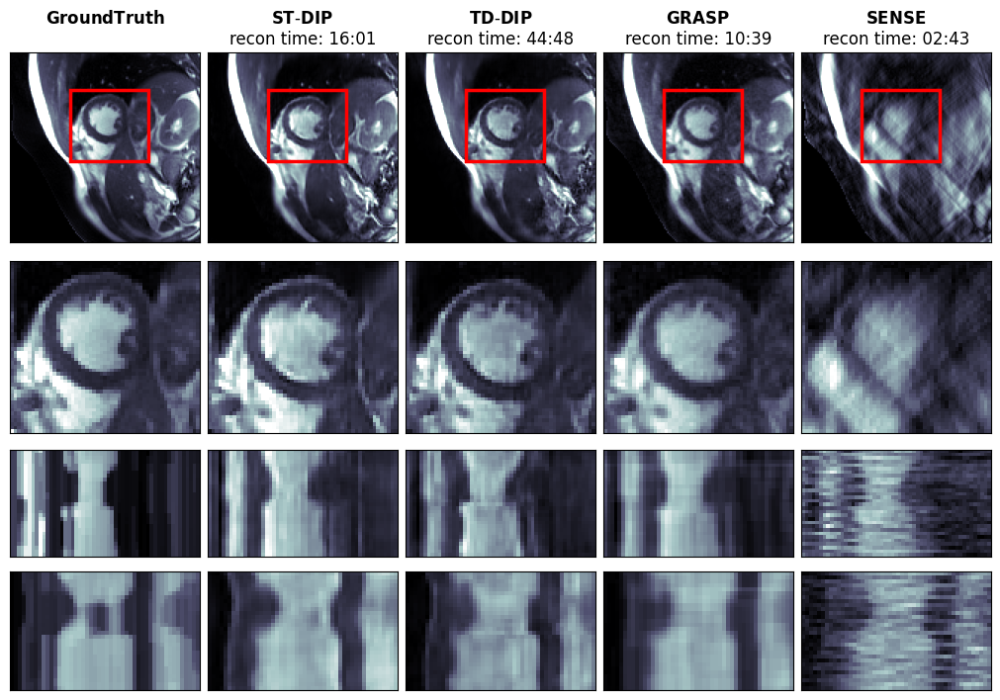

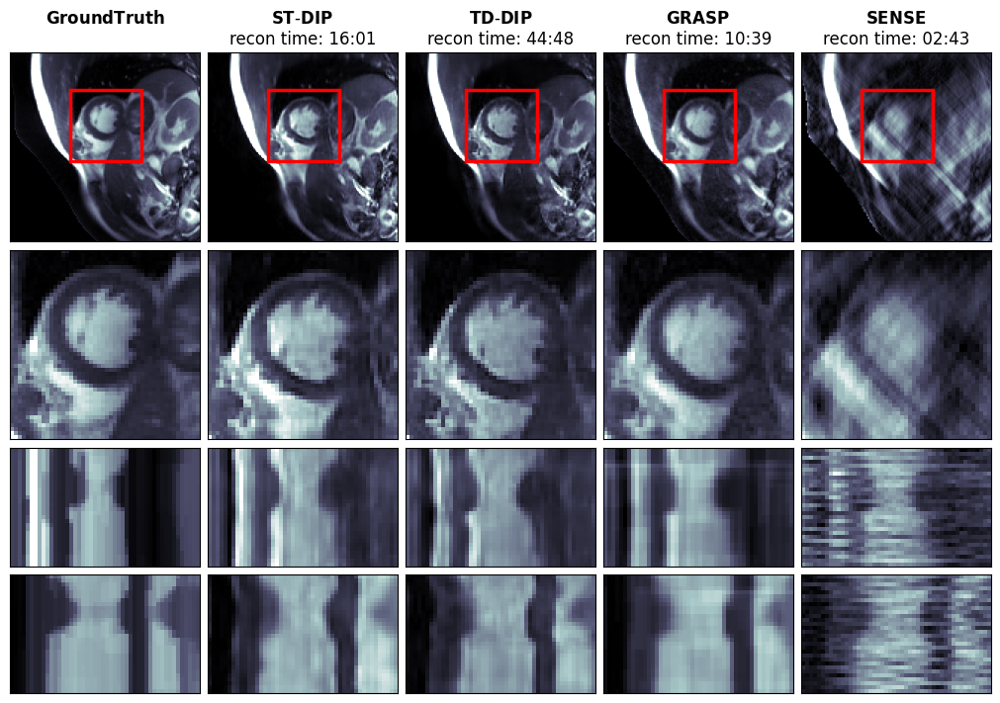

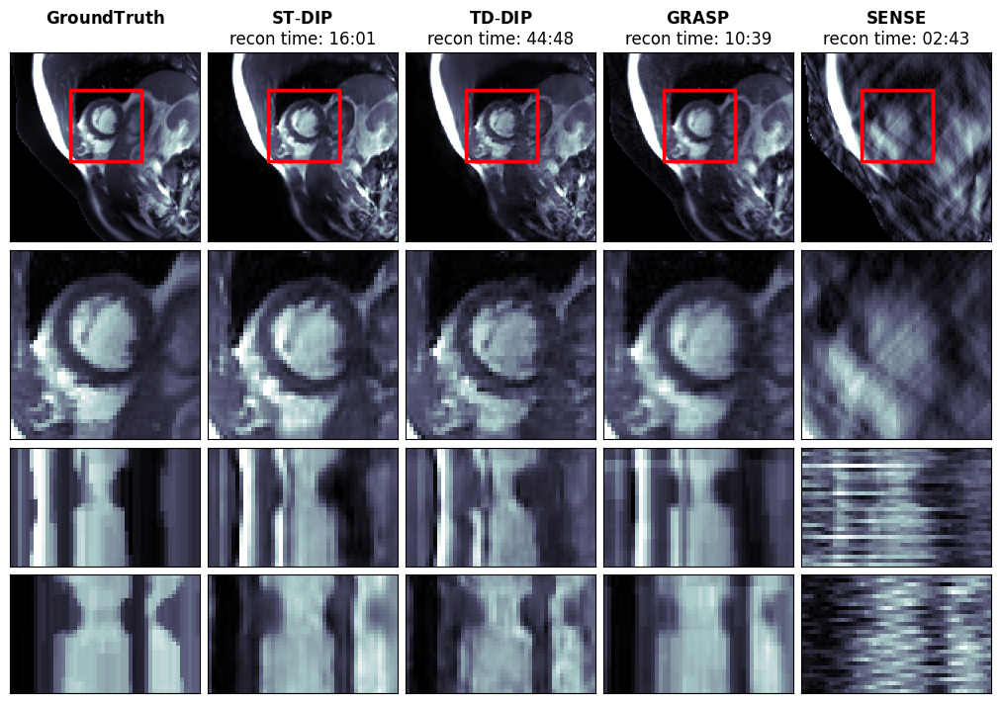

In [7]:
for volunteer in ['MP']: # , 'FH', 'TC', 'RF', 'JB', 'FE', 'DB', 'FP', 'AA', 'DP']:
    print('volunteer: ', volunteer)
    base_folder                = base_path + dataset + '/' + volunteer + '/'
    train_data_folder          = base_folder + 'traindata/'
    # ---   Datasets   ---
    # stDIP
    stdip_parameters['path']               = base_folder + 'stDIP'
    stdip_parameters['csv_path']           = stdip_parameters['path'] +  '/' + stdip_parameters['experiment_name'] + ".csv"
    stdip_parameters['csv_path_summary']   = stdip_parameters['path'] +  '/' + stdip_parameters['experiment_name'] + "_summary.csv"
    df_stdip                               = pd.read_csv(stdip_parameters['csv_path'] , delimiter=';')
    df_stdip_summary                       = pd.read_csv(stdip_parameters['csv_path_summary'] , delimiter=';')
    # tdDIP
    tddip_parameters['path']               = base_folder + 'tdDIP'
    tddip_parameters['csv_path']           = tddip_parameters['path'] +  '/' + tddip_parameters['experiment_name'] + ".csv"
    tddip_parameters['csv_path_summary']   = tddip_parameters['path'] +  '/' + tddip_parameters['experiment_name'] + "_summary.csv"
    df_tddip                               = pd.read_csv(tddip_parameters['csv_path'] , delimiter=';')
    df_tddip_summary                       = pd.read_csv(tddip_parameters['csv_path_summary'] , delimiter=';')
    # compute total time for single-slice reconstructions
    # GRASP and SENSE
    total_time_grasp = 0
    total_time_sense = 0
    for i in range(total_slices):
        slice_item = i+1
        dataset_name       = 'slice_' + str(slice_item) + '_' + str(total_slices) +'_nbins' + str(num_frames)
        path_dataset       = train_data_folder + dataset_name + '.npz'
        data               = onp.load(path_dataset)
        total_time_grasp   += data["time_grasp"]
        total_time_sense   += data["time_sense"]
    # TD-DIP
    tdDIP_summary_results             =    filter_and_get_columns(df_tddip_summary, tddip_summray_parameters, ['duration [s]_mean'])[0]
    total_time_recon_tdDIP            =    tdDIP_summary_results['duration [s]_mean'] * total_slices
    
    for slice_num in [1,2,3,4,5,6,7,8]:
        print('slice_num: ', slice_num)
        stdip_parameters['slice'] = slice_num
        tddip_parameters['slice'] = slice_num
        
        # --- PATH ---
        dataset_name          = 'slice_' + str(slice_num) + '_' + str(total_slices) +'_nbins' + str(num_frames)
        path_dataset          = train_data_folder + dataset_name + '.npz'
        # comparison folder
        comparison_folder = base_folder + 'comparison/'
        if not os.path.exists(comparison_folder):
            os.makedirs(comparison_folder)
        # export folder
        export_folder = base_folder + 'export/'
        if not os.path.exists(export_folder):
            os.makedirs(export_folder)

        # Ground truth data
        data         = onp.load(path_dataset)
        recon_grasp  = data["recon_grasp"]
        recon_sense  = data["recon_sense"]
        recon_fs     = data["recon_fs"]
        time_grasp   = data["time_grasp"]
        time_sense   = data["time_sense"]
        
        recon_grasp    = get_center(recon_grasp) 
        recon_sense    = get_center(recon_sense)
        recon_fs       = get_center(recon_fs) 
        
        recon_grasp    = safe_normalize(recon_grasp) 
        recon_sense    = safe_normalize(recon_sense) 
        recon_fs       = safe_normalize(recon_fs) 

        reference_metrics = {
            'time_grasp':     time_grasp,
            'time_sense':     time_sense,
            'time_grasp_str': seconds_to_min_sec_format(time_grasp),
            'time_sense_str': seconds_to_min_sec_format(time_sense),
            'psnr_grasp':     mean_psnr(recon_grasp, recon_fs),
            'psnr_sense':     mean_psnr(recon_sense, recon_fs),
            'ssim_grasp':     mean_ssim(recon_grasp, recon_fs),
            'ssim_sense':     mean_ssim(recon_sense, recon_fs),
            'psnr_grasp_str':     str(round(float(mean_psnr(recon_grasp, recon_fs)),1)),
            'psnr_sense_str':     str(round(float(mean_psnr(recon_sense, recon_fs)),1)),
            'ssim_grasp_str':     str(round(float(mean_ssim(recon_grasp, recon_fs)),3)),
            'ssim_sense_str':     str(round(float(mean_ssim(recon_sense, recon_fs)),3)),
        }

        # Models reconstructions
        # stDIP
        stdip_parameters['exp_folder_path']    = stdip_parameters['path'] +  '/' + dataset_name + '/' + stdip_parameters['experiment_name']
        stDIP_results                          = filter_and_get_columns(df_stdip, stdip_parameters['training_params'], target_columns)[0]
        stdip_parameters['best_recon_path']    = stdip_parameters['exp_folder_path'] +  '/' + stDIP_results['training_name'] + '/' + 'best_recon.npz'
        stDIP_results['recon']     = onp.load(stdip_parameters['best_recon_path'], allow_pickle=True)['best_recon']
        # tdDIP
        tddip_parameters['exp_folder_path']    = tddip_parameters['path'] +  '/' + dataset_name + '/' + tddip_parameters['experiment_name']
        tdDIP_results                          = filter_and_get_columns(df_tddip, tddip_parameters['training_params'], target_columns)[0]
        tddip_parameters['best_recon_path']    = tddip_parameters['exp_folder_path'] +  '/' + tdDIP_results['training_name'] + '/' + 'best_recon.npz'
        tdDIP_results['recon']     = onp.load(tddip_parameters['best_recon_path'], allow_pickle=True)['best_recon']
        # preprocess
        stDIP_results['recon']     = safe_normalize(stDIP_results['recon'] ) 
        tdDIP_results['recon']     = safe_normalize(tdDIP_results['recon'] ) 
        # Comparison of models
        comparison_folder = base_folder + 'comparison/'
        if not os.path.exists(comparison_folder):
            os.makedirs(comparison_folder)
        gt_title    = r'$\mathbf{Ground Truth}$'
        stdip_title = r'$\mathbf{ST\text{-}DIP}$'
        tddip_title = r'$\mathbf{TD\text{-}DIP}$'
        grasp_title = r'$\mathbf{GRASP}$'
        sense_title = r'$\mathbf{SENSE}$'
        if add_psnr:
            gt_title    += '\n '
            stdip_title += '\npsnr: ' + str(round(stDIP_results['psnr'],1))
            tddip_title += '\npsnr: ' + str(round(tdDIP_results['psnr'],1))
            grasp_title += '\npsnr: ' + reference_metrics['psnr_grasp_str']
            sense_title += '\npsnr: ' + reference_metrics['psnr_sense_str']
        
        if add_ssim:
            gt_title    += '\n '
            stdip_title += '\nssim: ' + str(round(stDIP_results['ssim'],3))
            tddip_title += '\nssim: ' + str(round(tdDIP_results['ssim'],3))
            grasp_title += '\nssim: ' + reference_metrics['ssim_grasp_str']
            sense_title += '\nssim: ' + reference_metrics['ssim_sense_str']
        
        if add_time:
            gt_title    += '\n '
            stdip_title += '\nrecon time: ' + seconds_to_min_sec_format(stDIP_results['duration [s]'])
            tddip_title += '\nrecon time: ' + seconds_to_min_sec_format(total_time_recon_tdDIP)
            grasp_title += '\nrecon time: ' + seconds_to_min_sec_format(total_time_grasp)
            sense_title += '\nrecon time: ' + seconds_to_min_sec_format(total_time_sense)
        
        stDIP_results['name'] = stdip_title
        tdDIP_results['name'] = tddip_title
        name_grasp            = grasp_title
        name_sense            = sense_title
        
        stDIP_results['recon_trans'] = apply_transform(stDIP_results['recon'], dataset, volunteer, dict_trans)
        tdDIP_results['recon_trans'] = apply_transform(tdDIP_results['recon'], dataset, volunteer, dict_trans)
        recon_grasp_trans = apply_transform(recon_grasp, dataset, volunteer, dict_trans)
        recon_sense_trans = apply_transform(recon_sense, dataset, volunteer, dict_trans)
        if volunteer in ['FP', 'DP']:
            recon_fs_trans = apply_transform(recon_fs, dataset, volunteer, gt_trans)
        else:
            recon_fs_trans = apply_transform(recon_fs, dataset, volunteer, dict_trans)
        
        matrix_list  = [recon_fs_trans, stDIP_results['recon_trans'], tdDIP_results['recon_trans'] , recon_grasp_trans, recon_sense_trans]
        matrix_names = [gt_title, stDIP_results['name'], tdDIP_results['name'] , name_grasp , name_sense ]
        
        crop_ns       = dict_plot[dataset][volunteer][slice_num]['crop_ns']
        saturation    = dict_plot[dataset][volunteer][slice_num]['saturation']
        frame = 0
        
        fig, axs = full_halph_FOV_space_time(matrix_list, crop_ns=crop_ns, saturation=saturation, frame=frame, xy_proportion=(2,7))
        for ax, title in zip(axs, matrix_names):
            ax[0].set_title(title)
        fig.savefig( comparison_folder + volunteer + '_slice' + str(slice_num) + ".png", dpi=300, bbox_inches='tight')
        # export
        comparison_folder + 'slice' + str(slice_num) + ".png"
        affine = np.eye(4)
        
        recon_fs_nii = nib.Nifti1Image(recon_fs_trans, affine)
        nib.save(recon_fs_nii, export_folder + volunteer + '_recon_fs' + '_slice' + str(slice_num) + '.nii') 
        
        stdip_nii = nib.Nifti1Image(stDIP_results['recon_trans'], affine)
        nib.save(stdip_nii, export_folder + volunteer + '_stdip' + '_slice' + str(slice_num) + '.nii') 
        
        tddip_nii = nib.Nifti1Image(tdDIP_results['recon_trans'], affine)
        nib.save(tddip_nii, export_folder + volunteer + '_tddip' + '_slice' + str(slice_num) + '.nii')
        
        grasp_nii = nib.Nifti1Image(recon_grasp_trans, affine)
        nib.save(grasp_nii,  export_folder +  volunteer + '_grasp' + '_slice' + str(slice_num) + '.nii') 